## Load and Summary

In [1]:
# read rds file
import pyreadr

rds_path1 = "/projects/wangc/m344313/OVTMA_project/data/bms1/bms1_part1.rds"

# read rds file
r1 = pyreadr.read_r(rds_path1)

# read rds file
rds_path2 = "/projects/wangc/m344313/OVTMA_project/data/bms1/bms1_part2.rds"

# read rds file
r2 = pyreadr.read_r(rds_path2)


In [2]:
import pandas as pd
# get the 1st item of the iterator
df1 = next(iter(r1.items()))[1]
df2 = next(iter(r2.items()))[1]
raw_df = pd.concat([df1, df2])
print(raw_df.shape)
print(raw_df.head())

# raw_df.to_csv('/projects/wangc/m344313/OVTMA_project/data/bms1/full_df.csv')
# raw_df[raw_df['fov'] == 'stroma'].to_csv('/projects/wangc/m344313/OVTMA_project/data/bms1/stroma_df.csv')
# raw_df[raw_df['fov'] == 'tumor'].to_csv('/projects/wangc/m344313/OVTMA_project/data/bms1/tumor_df.csv')
# raw_df[raw_df['fov'] == 'interface'].to_csv('/projects/wangc/m344313/OVTMA_project/data/bms1/interface_df.csv')


(3649983, 7)
  patientID    imageID  responder        fov        x       y  \
0     Mel30  Mel30_001          0  interface   982.39  1186.2   
1     Mel30  Mel30_001          0  interface  1377.90  1183.1   
2     Mel30  Mel30_001          0  interface  1656.50  1177.9   
3     Mel30  Mel30_001          0  interface    72.73  1175.6   
4     Mel30  Mel30_001          0  interface   345.14  1179.3   

          cell_type  
0  Cytotoxic T Cell  
1            B Cell  
2            B Cell  
3    Dendritic Cell  
4        Tumor Cell  


### Prepare for plotting HE overlay

In [17]:
# for patientID == 'Mel43' or 'Mel44', get the fov value for each unique imageID

subset = raw_df[raw_df["patientID"].isin(["Mel43", "Mel44"])]
result = (
    subset.groupby("imageID")["fov"].unique()
    .explode()               # turn each list into multiple rows
    .reset_index()
)
print(result.head())
result.rename(columns={'imageID':'Sample','fov':'Pathology'}, inplace=True)
result['Slide'] = result['Sample'].str.split('_', expand=True)[0]+'_BMS'

result['Sample'] = result['Slide']+'_region_'+result['Sample'].str.split('_', expand=True)[1]
print(result.head())
result.to_csv('/people/m344313/Map_FOV_Back_On_vHnE/labels.csv',index=False)


     imageID        fov
0  Mel43_001  interface
1  Mel43_002  interface
2  Mel43_003  interface
3  Mel43_004  interface
4  Mel43_005  interface
                 Sample  Pathology      Slide
0  Mel43_BMS_region_001  interface  Mel43_BMS
1  Mel43_BMS_region_002  interface  Mel43_BMS
2  Mel43_BMS_region_003  interface  Mel43_BMS
3  Mel43_BMS_region_004  interface  Mel43_BMS
4  Mel43_BMS_region_005  interface  Mel43_BMS


In [14]:
print(raw_df['patientID'].value_counts())
print(raw_df['imageID'].value_counts())
print(raw_df['fov'].value_counts())
print(raw_df['cell_type'].value_counts())

print(raw_df.groupby('responder')['patientID'].nunique())
print(raw_df.groupby('patientID')['imageID'].nunique())
print(raw_df.groupby('fov')['imageID'].nunique())

print(f'{len(raw_df["patientID"].unique())} patients, {len(raw_df["imageID"].unique())} images, {len(raw_df["cell_type"].unique())} cell types')
print(f'{raw_df.groupby("responder")["patientID"].nunique()}')

patientID
Mel55    320393
Mel49    231512
Mel51    207333
Mel36    200436
Mel38    193418
Mel46    192644
Mel54    189730
Mel52    185464
Mel30    181360
Mel40    176897
Mel44    175334
Mel41    168616
Mel45    159185
Mel48    153318
Mel43    153154
Mel50    146671
Mel35    137126
Mel47    115691
Mel53     94207
Mel42     89335
Mel39     79937
Mel56     70964
Mel68     27258
Name: count, dtype: int64
imageID
Mel30_029    10794
Mel30_028    10743
Mel46_030    10471
Mel51_031    10448
Mel38_015    10302
             ...  
Mel53_022     1752
Mel35_012     1737
Mel35_029     1728
Mel50_018     1593
Mel47_012     1451
Name: count, Length: 711, dtype: int64
fov
stroma       1629500
interface    1148907
tumor         871576
Name: count, dtype: int64
cell_type
Tumor Cell             1024164
B Cell                  781536
Helper T Cell           520667
Macrophage              365535
Cytotoxic T Cell        350879
Stromal Cell            203268
Dendritic Cell          137190
Regulatory T Cell   

## intact vs mixed

### Moran's I (tumor vs non-tumor)

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from libpysal.weights import KNN, DistanceBand, WSP
from esda.moran import Moran
import statsmodels.formula.api as smf

# assume df has columns: patientID, imageID, responder, fov, x, y, cell_type
df = raw_df.copy()
df = df[df['fov'] == 'interface']
df["cell_type"] = np.where(df["cell_type"].values == "Tumor Cell", "Tumor", "Non Tumor")
df["tumor_bin"] = (df["cell_type"] == "Tumor").astype(float)



In [30]:

def moran_for_group(coords: np.ndarray, values: np.ndarray, method="knn", k=10, radius=None):
    """
    Compute Moran's I given coordinates (N x 2) and values (N,).
    method: 'knn' or 'radius'
    - knn: uses KNN.from_array 
    - radius: uses DistanceBand.from_array (neighbors within radius)
    Returns: float Moran's I
    """
    if coords.shape[0] < 3:
        return np.nan
    if method == "knn":
        w = KNN.from_array(coords, k=k)
    elif method == "radius":
        if radius is None:
            raise ValueError("Provide 'radius' (same units as x/y) for method='radius'")
        
        w = DistanceBand.from_array(coords, threshold=radius, binary=True, silence_warnings=True)
        # Guard for isolated points: if everyone is isolated, Moran is undefined
        if w.n_components > 1 and w.s0 == 0:
            return np.nan
    else:
        raise ValueError("method must be 'knn' or 'radius'")
    mi = Moran(values, w)
    return float(mi.I)

results = []
#(A) fast KNN or (B) fixed-radius
USE_METHOD = "radius"    # or "radius"
K = 10                
RADIUS = 50         

for img, g in df.groupby("imageID", sort=False):
    coords = g[["x","y"]].to_numpy()
    vals = g["tumor_bin"].to_numpy(dtype=float)
    I = moran_for_group(coords, vals, method=USE_METHOD, k=K, radius=RADIUS)
    results.append({"imageID": img,
                    "moran_I": I,
                    "responder": g["responder"].iloc[0]})

moran_df = pd.DataFrame(results).dropna(subset=["moran_I"]).reset_index(drop=True)


In [33]:
g

,patientID,imageID,responder,fov,x,y,cell_type,cell_class,tumor_bin
1720798,Mel46,Mel46_002,1,interface,436.94,1079.20,Tumor Cell,Tumor,1.0
1720799,Mel46,Mel46_002,1,interface,402.13,1064.10,Tumor Cell,Tumor,1.0
1720800,Mel46,Mel46_002,1,interface,264.99,1079.30,Tumor Cell,Tumor,1.0
1720801,Mel46,Mel46_002,1,interface,1874.40,1062.00,Tumor Cell,Tumor,1.0
1720802,Mel46,Mel46_002,1,interface,1828.30,1062.30,Dendritic Cell,Non Tumor,0.0
...,...,...,...,...,...,...,...,...,...
1726499,Mel46,Mel46_002,1,interface,1408.60,877.69,B Cell,Non Tumor,0.0
1726500,Mel46,Mel46_002,1,interface,1610.20,876.85,Macrophage,Non Tumor,0.0
1726501,Mel46,Mel46_002,1,interface,1643.20,877.83,Macrophage,Non Tumor,0.0
1726502,Mel46,Mel46_002,1,interface,782.58,879.00,Tumor Cell,Tumor,1.0


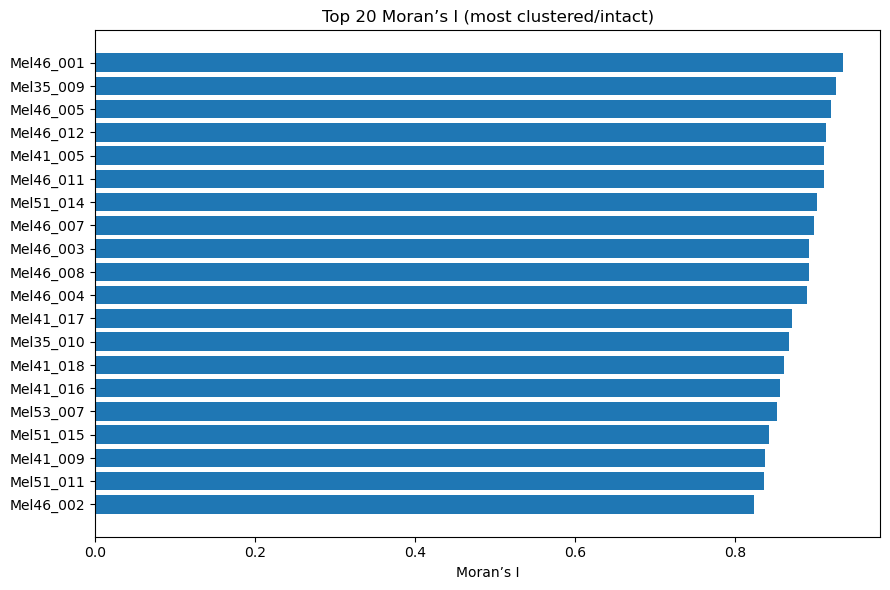

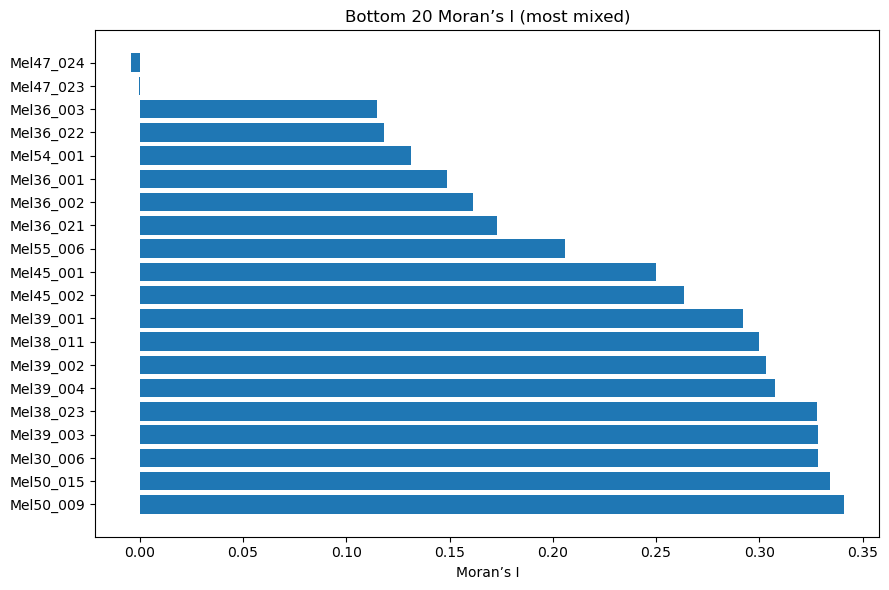

In [39]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
# 2) Plot top/bottom 20
top20 = moran_df.nlargest(20, "moran_I")
bot20 = moran_df.nsmallest(20, "moran_I")

plt.figure(figsize=(9,6))
plt.barh(top20["imageID"].astype(str), top20["moran_I"])
plt.gca().invert_yaxis()
plt.title("Top 20 Moran’s I (most clustered/intact)")
plt.xlabel("Moran’s I"); plt.tight_layout(); plt.show()

plt.figure(figsize=(9,6))
plt.barh(bot20["imageID"].astype(str), bot20["moran_I"])
plt.gca().invert_yaxis()
plt.title("Bottom 20 Moran’s I (most mixed)")
plt.xlabel("Moran’s I"); plt.tight_layout(); plt.show()



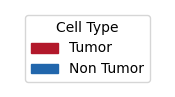

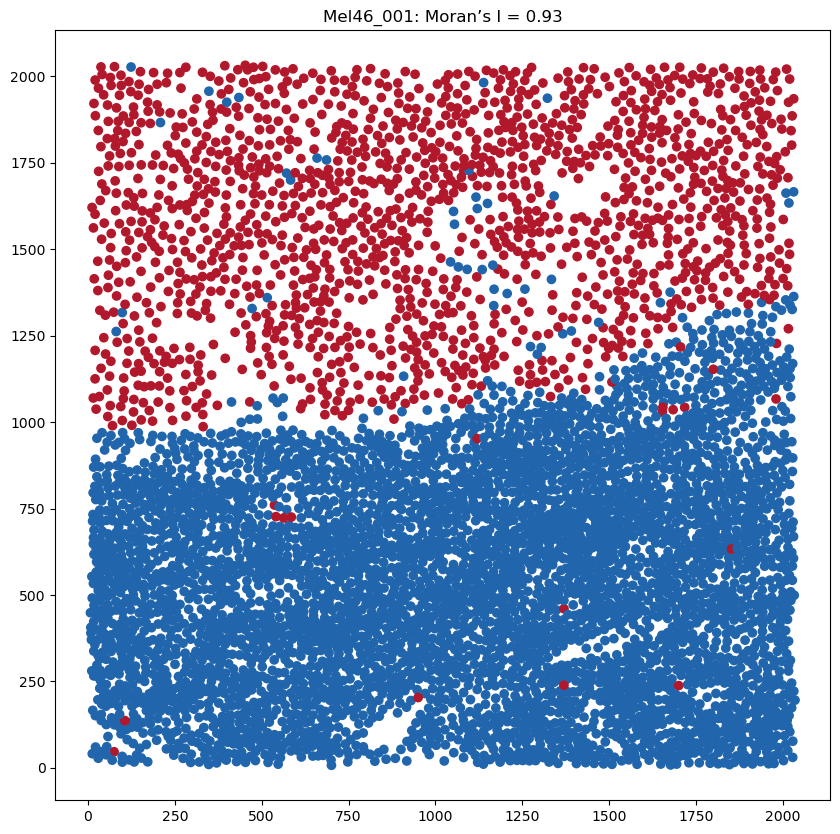

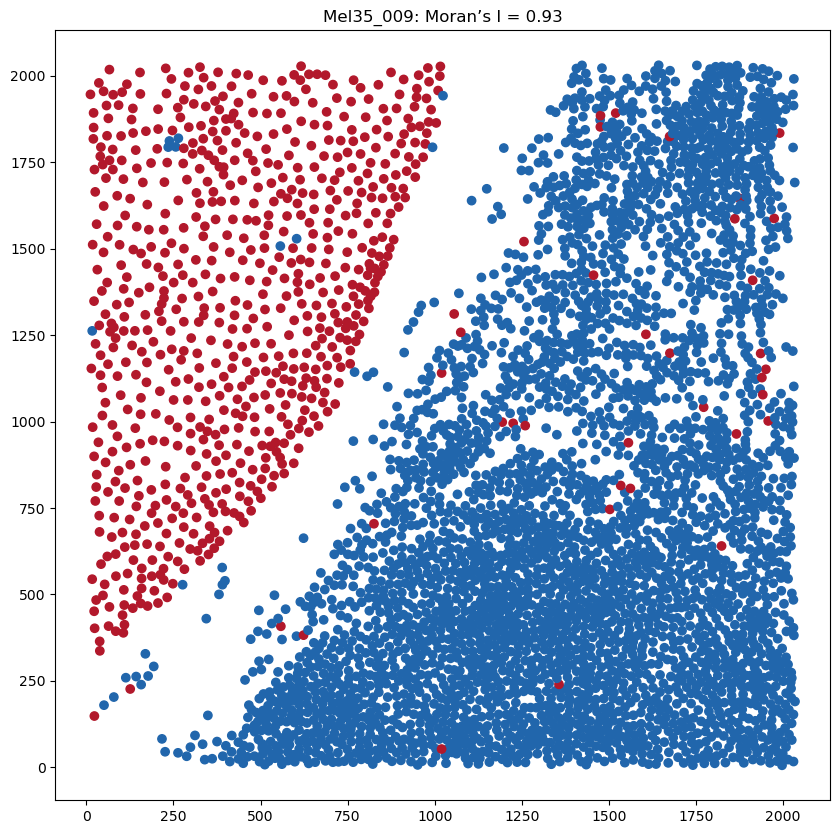

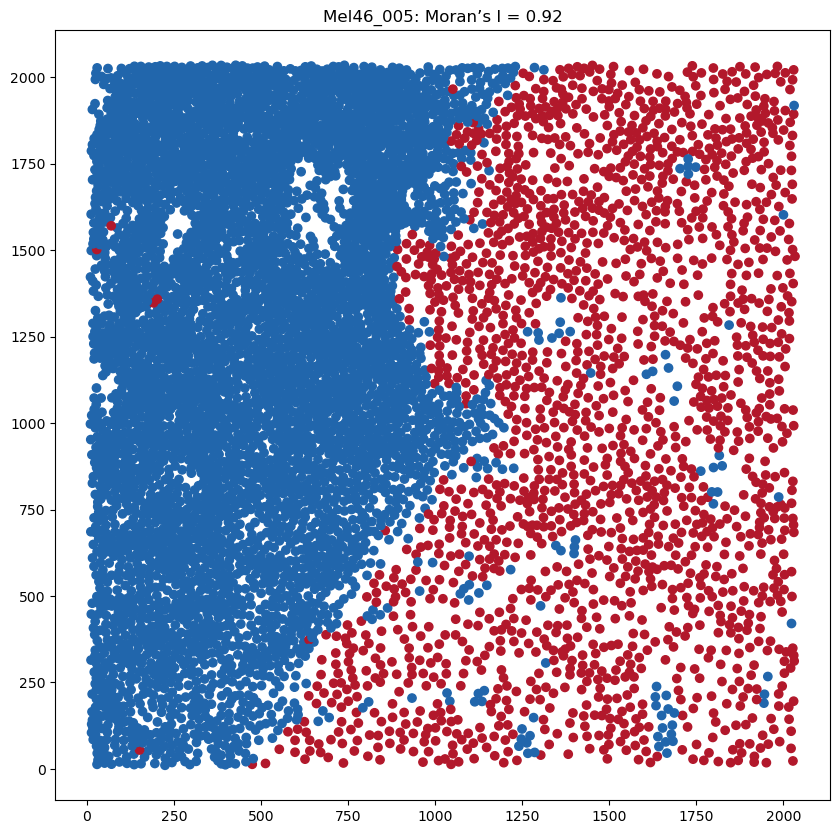

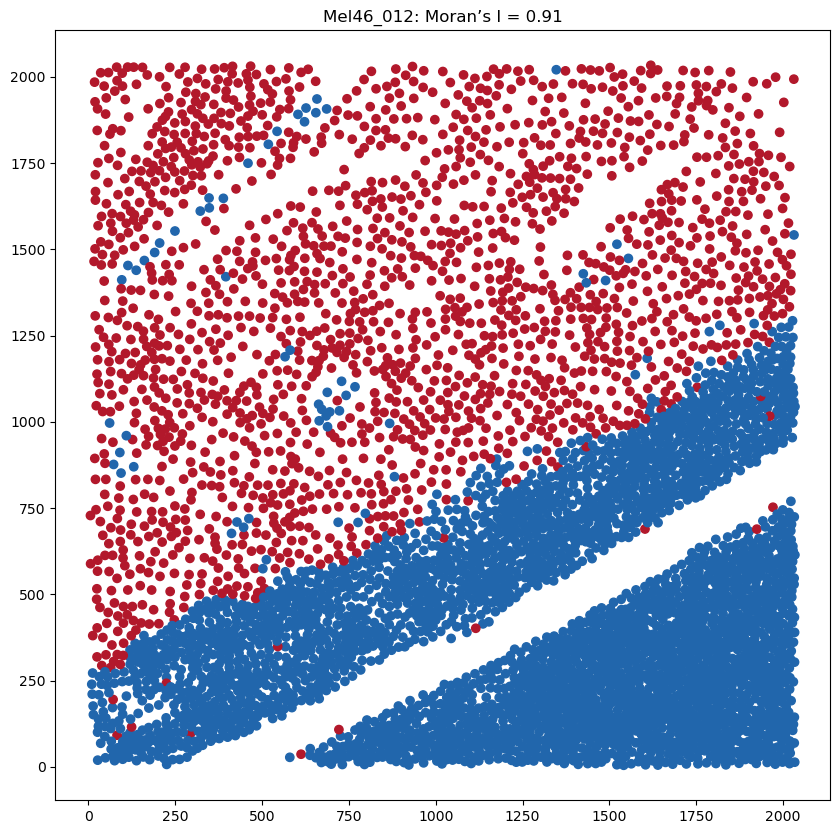

...

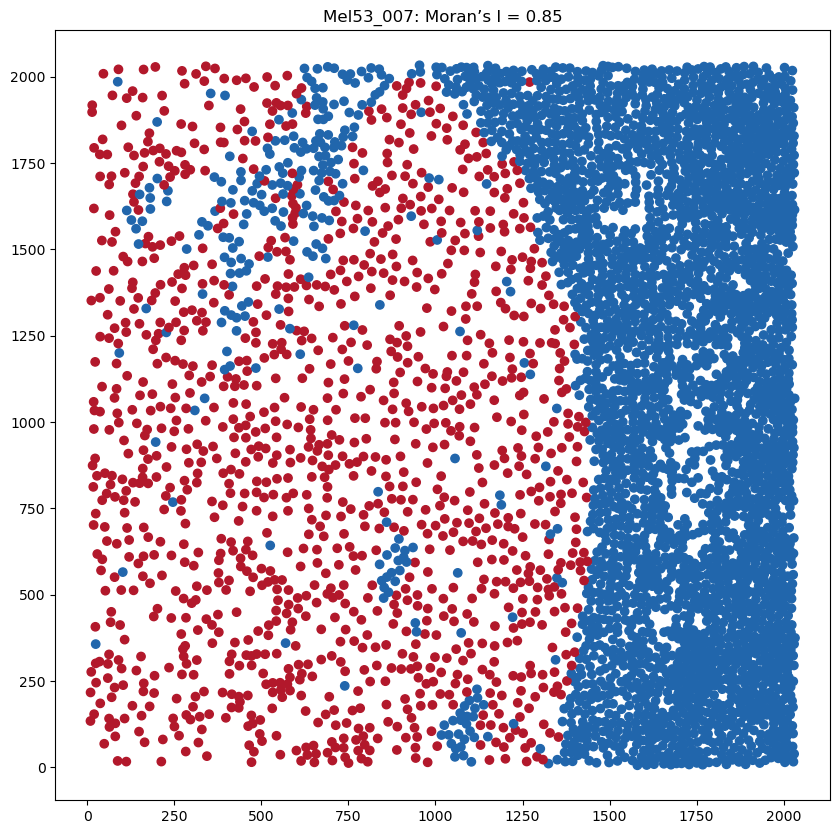

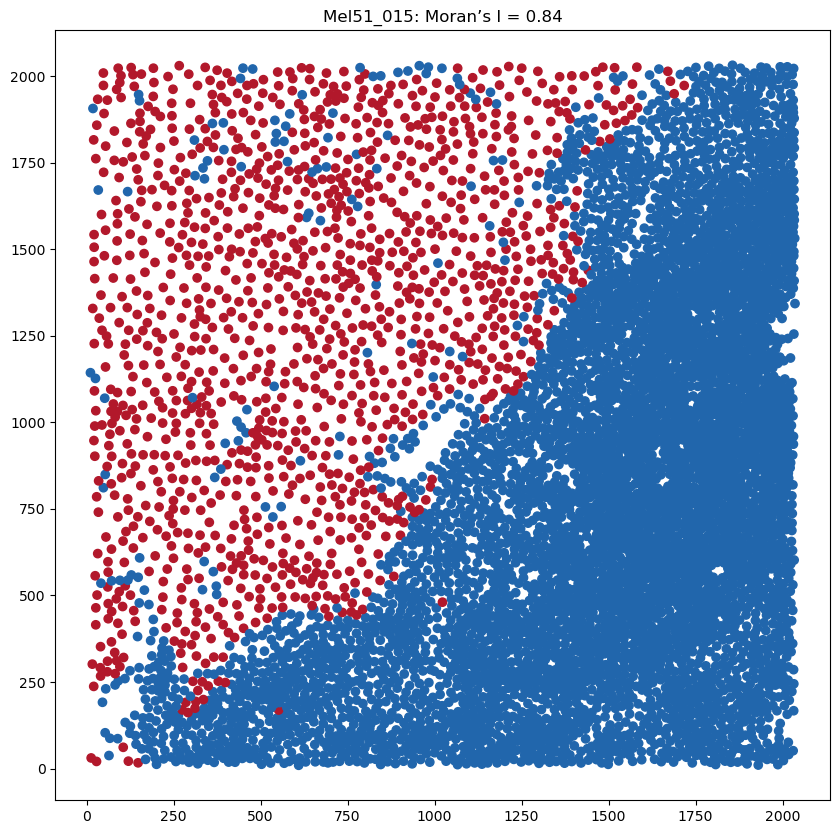

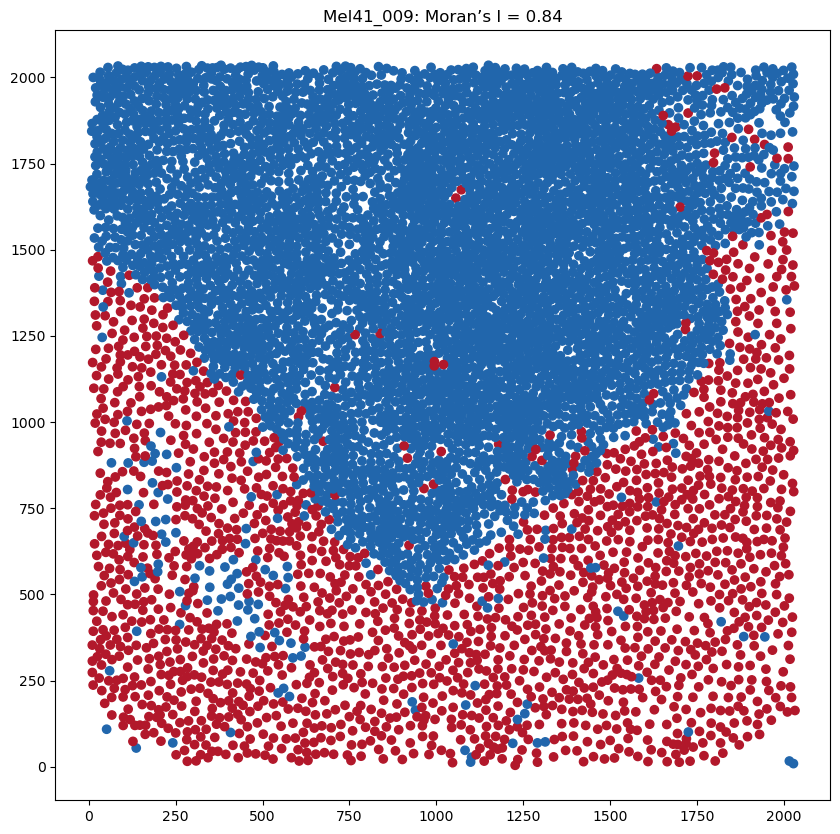

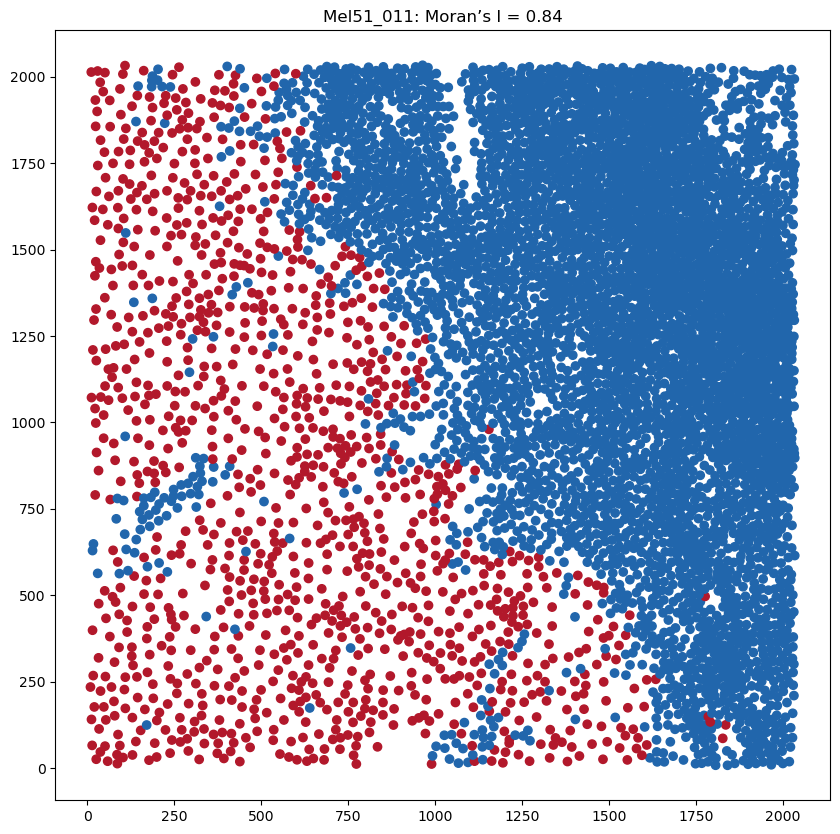

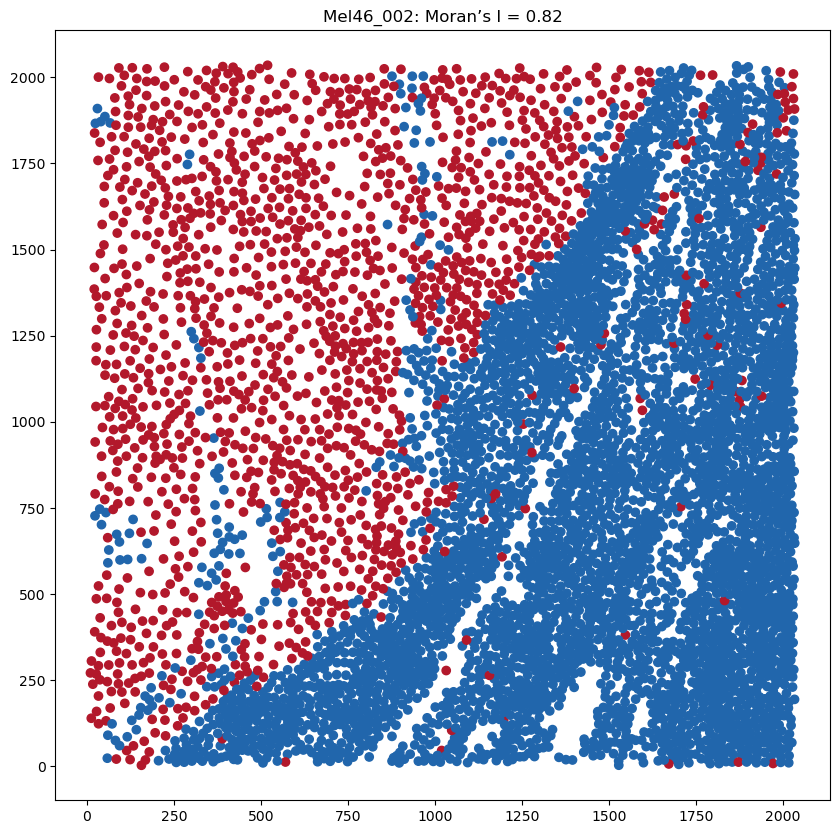

In [ ]:
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

color_map = {'Tumor': '#b2182b', 'Non Tumor': '#2166ac'} # Crimson and Dark blue

# Create legend handles
handles = [mpatches.Patch(color=color, label=label) for label, color in color_map.items()]

fig_legend = plt.figure(figsize=(2, 1))
fig_legend.legend(handles=handles, title="Cell Type", loc='center')
plt.axis('off')  # hide any axes
plt.show()

for img in top20["imageID"]:
    g = df[df["imageID"] == img]

    colors = g["cell_type"].map(color_map)
    plt.figure(figsize=(10,10))
    plt.scatter(g["x"], g["y"], c=colors)
    plt.title(f'{img}: Moran’s I = {top20[top20["imageID"] == img]["moran_I"].values[0]:.2f}')
    plt.show()


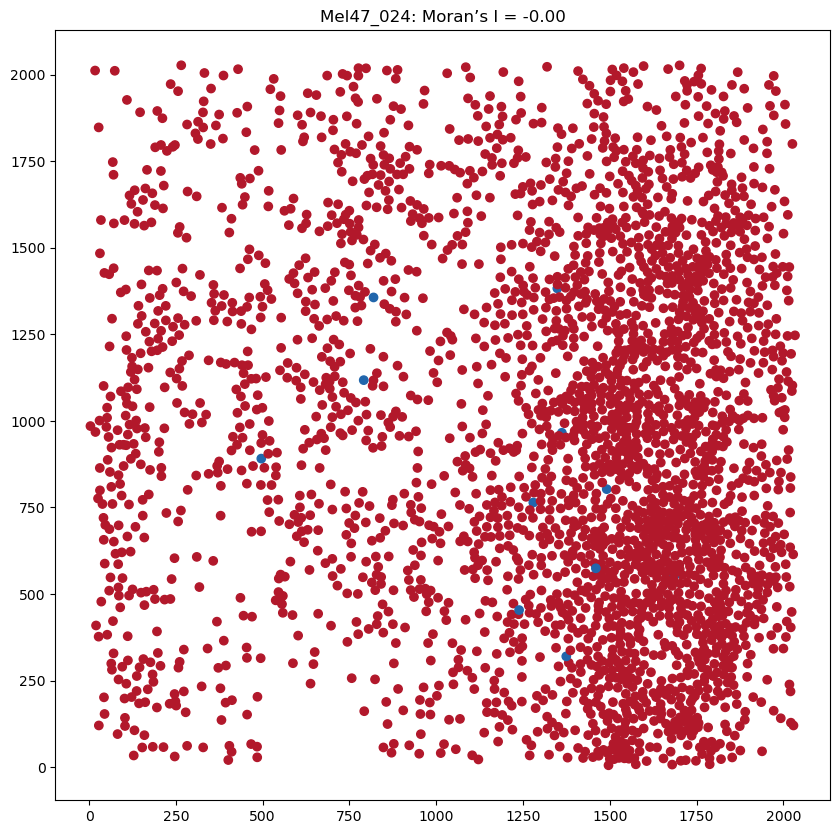

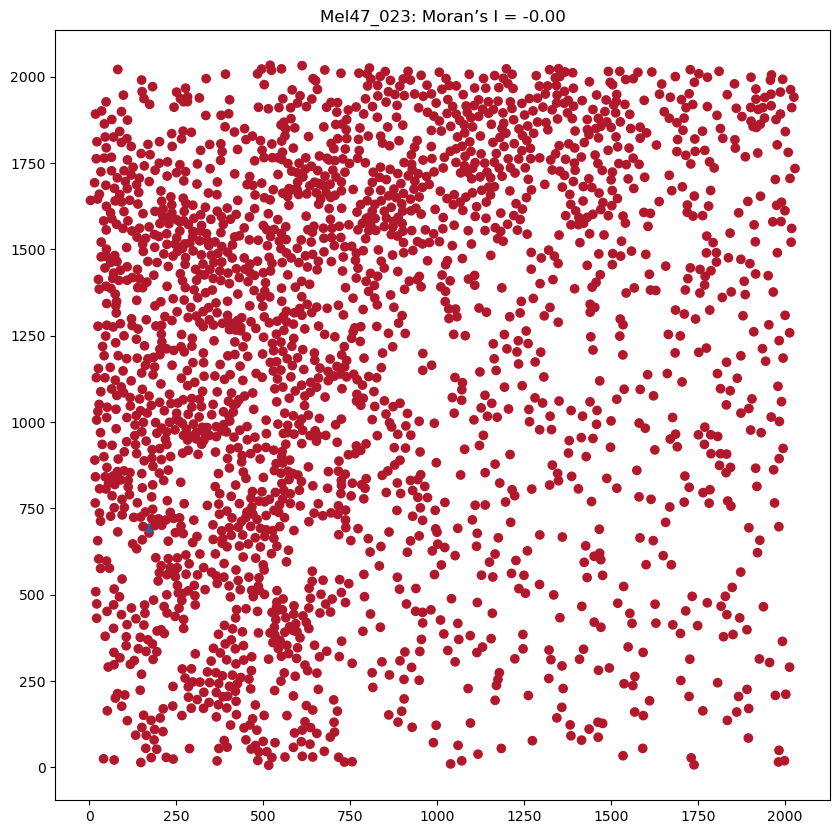

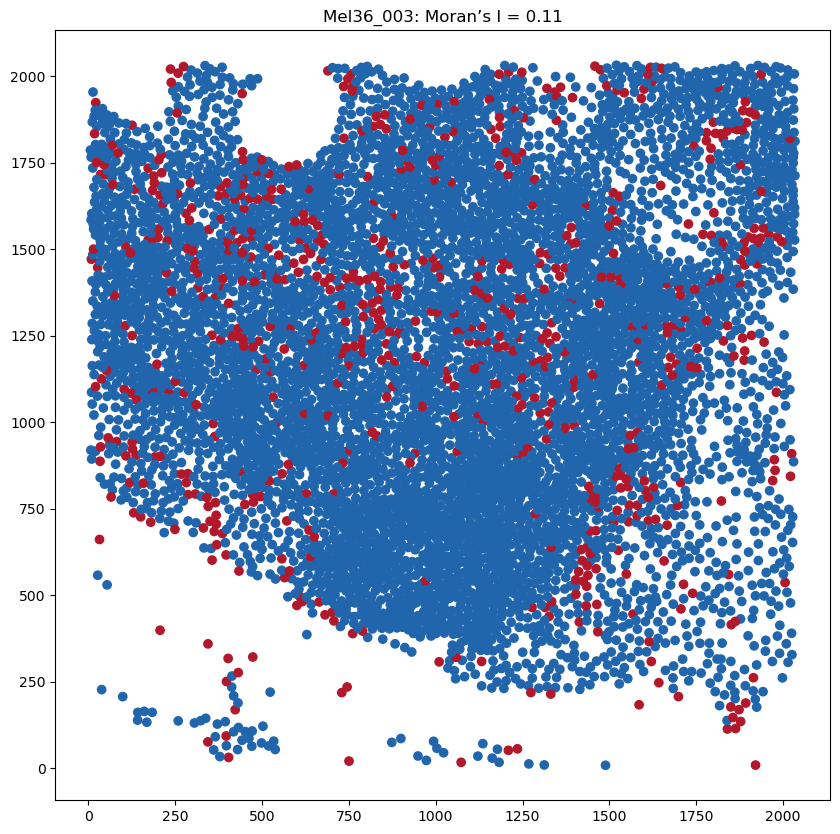

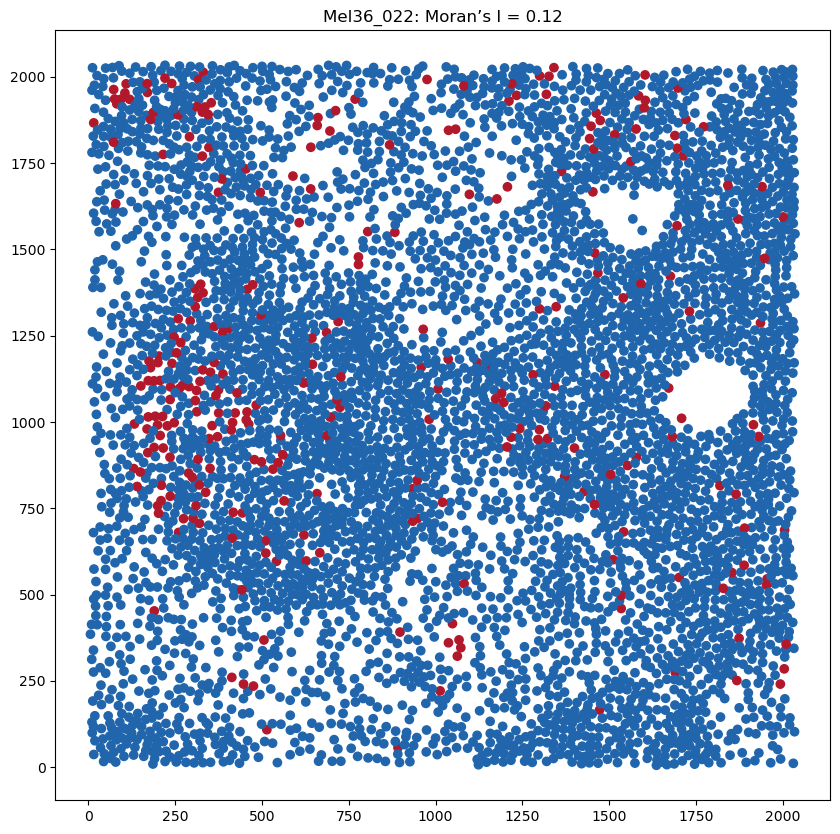

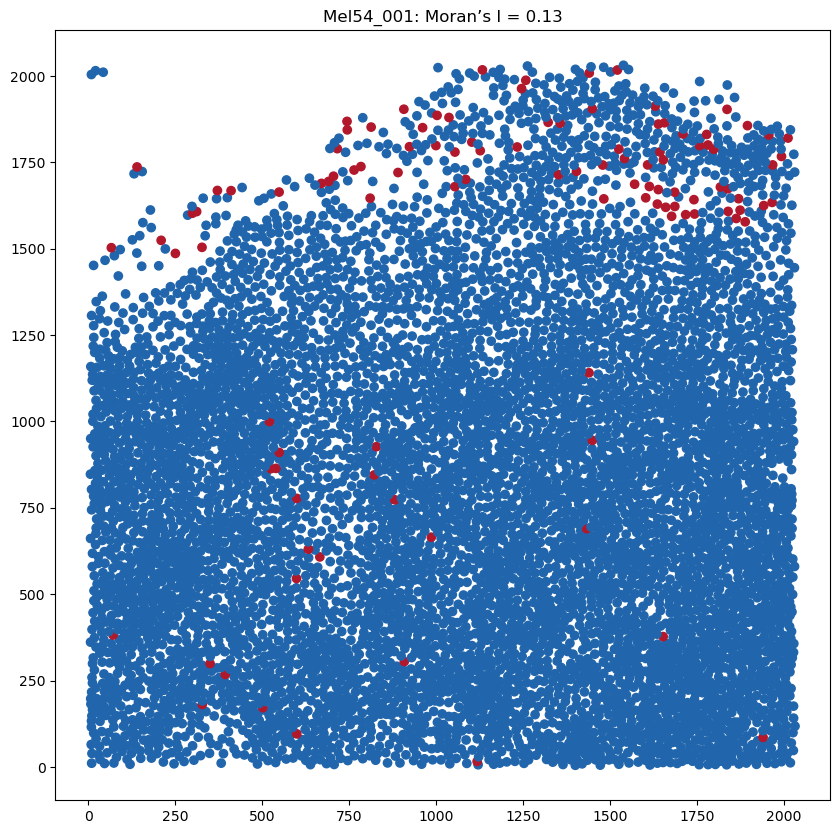

...

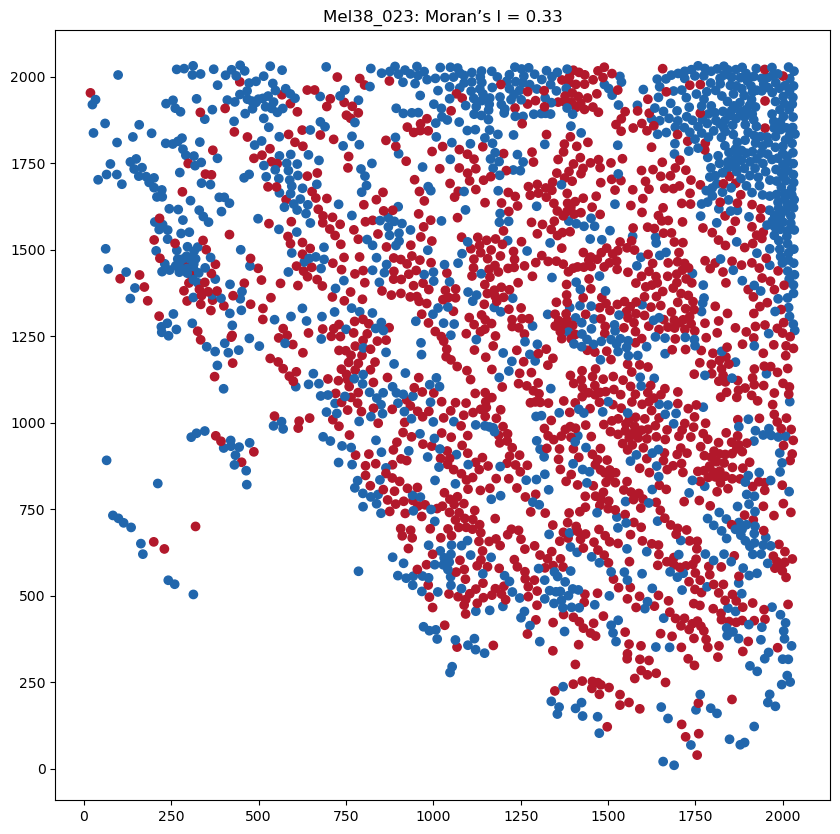

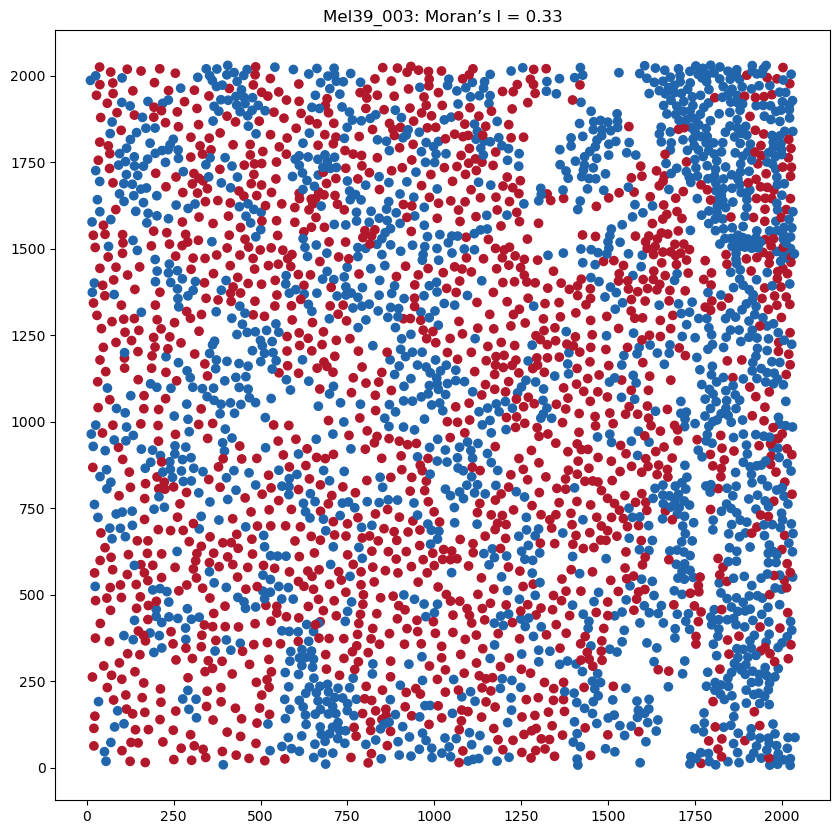

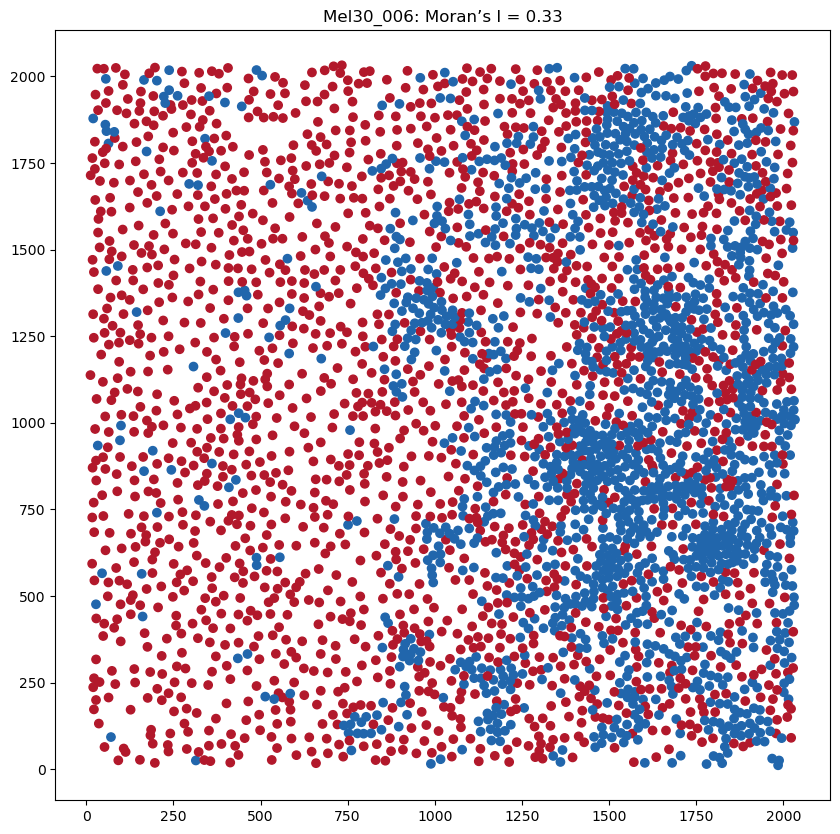

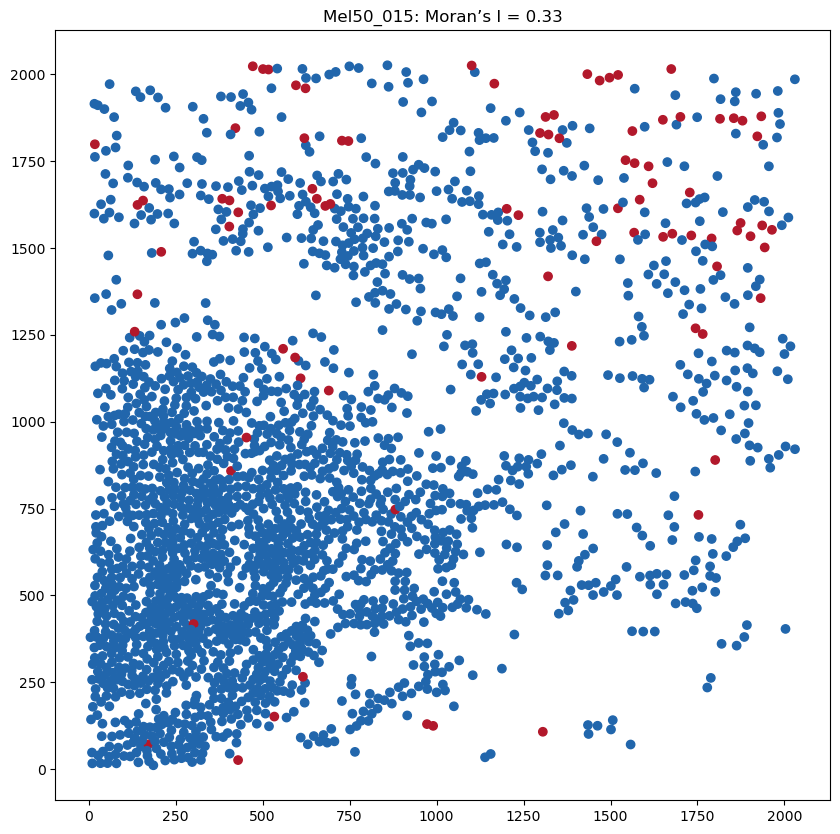

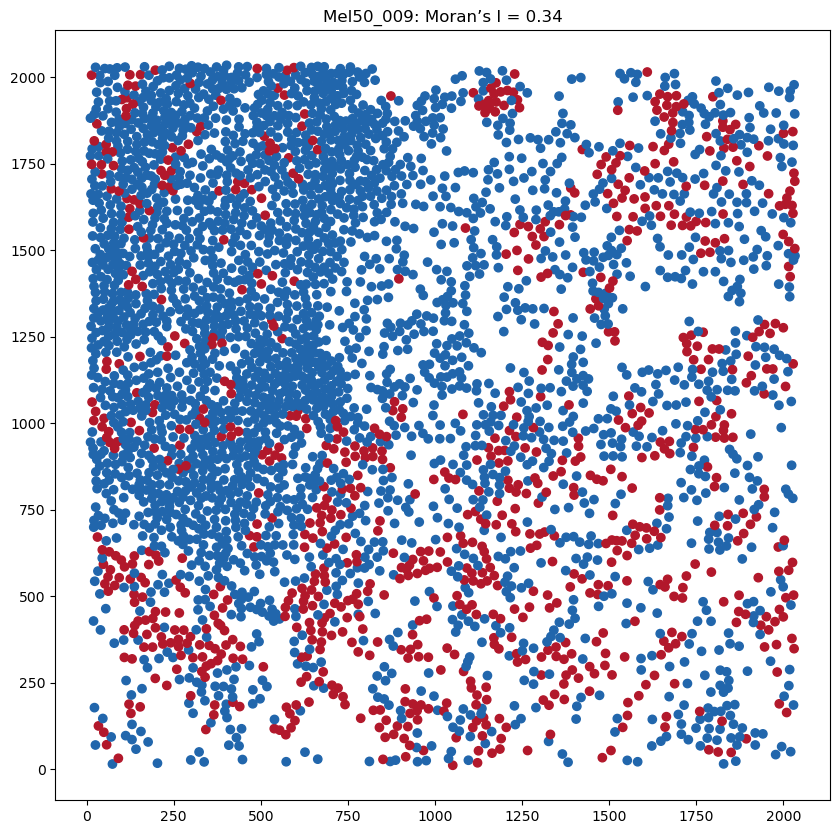

In [45]:
for img in bot20["imageID"]:
    g = df[df["imageID"] == img]

    colors = g["cell_type"].map(color_map)
    plt.figure(figsize=(10,10))
    plt.scatter(g["x"], g["y"], c=colors)
    plt.title(f'{img}: Moran’s I = {bot20[bot20["imageID"] == img]["moran_I"].values[0]:.2f}')
    plt.show()

In [ ]:

# 3) Regression: same responder per imageID
# If responder is binary string/label, encode to 0/1. If numeric already, this will keep it.
moran_df["resp_num"] = moran_df["responder"].astype("category").cat.codes
# Linear regression: Moran’s I ~ responder (swap to logit if you want)
model = smf.ols("moran_I ~ resp_num", data=moran_df).fit()
print(model.summary())


### Calculate for XGboostPred

In [46]:
folder = '/projects/wangc/m344313/OVTMA_project/data/XGBoostPred/BMS_T1'
# read all csv files in the folder
import os
import pandas as pd

# Get list of all files in the folder
files = [f for f in os.listdir(folder) if f.endswith('.tsv')]

results = []
for file in files:
    df = pd.read_csv(os.path.join(folder, file), sep='\t')
    # get the imageID from the file name
    imageID = file.split('.')[0]
    df["XGBoostPrediction"] = np.where(df["XGBoostPrediction"].values == "Tumor Cell", "Tumor", "Non Tumor")
    df["tumor_bin"] = (df["XGBoostPrediction"] == "Tumor").astype(float)
    # calculate Moran's I
    coords = df[["Centroid_X_um","Centroid_Y_um"]].to_numpy()
    vals = df["tumor_bin"].to_numpy(dtype=float)
    I = moran_for_group(coords, vals, method=USE_METHOD, k=K, radius=RADIUS)
    results.append({"imageID": imageID,
                    "moran_I": I,
                    "responder": g["responder"].iloc[0]})
moran_df = pd.DataFrame(results).dropna(subset=["moran_I"]).reset_index(drop=True)
moran_df.to_csv('/projects/wangc/m344313/OVTMA_project/data/XGBoostPred/BMS_T1_moran_df.csv', index=False)



/people/m344313/.local/share/mamba/envs/tma22/lib/python3.10/site-packages/esda/moran.py:258: RuntimeWarning: invalid value encountered in scalar divide
  k = k_num / k_den
/people/m344313/.local/share/mamba/envs/tma22/lib/python3.10/site-packages/esda/moran.py:270: RuntimeWarning: invalid value encountered in scalar divide
  return self.n / s0 * inum / self.z2ss
/people/m344313/.local/share/mamba/envs/tma22/lib/python3.10/site-packages/esda/moran.py:227: RuntimeWarning: invalid value encountered in divide
  self.z /= sy
/people/m344313/.local/share/mamba/envs/tma22/lib/python3.10/site-packages/esda/moran.py:258: RuntimeWarning: invalid value encountered in scalar divide
  k = k_num / k_den
/people/m344313/.local/share/mamba/envs/tma22/lib/python3.10/site-packages/esda/moran.py:270: RuntimeWarning: invalid value encountered in scalar divide
  return self.n / s0 * inum / self.z2ss
/people/m344313/.local/share/mamba/envs/tma22/lib/python3.10/site-packages/esda/moran.py:227: RuntimeWarnin

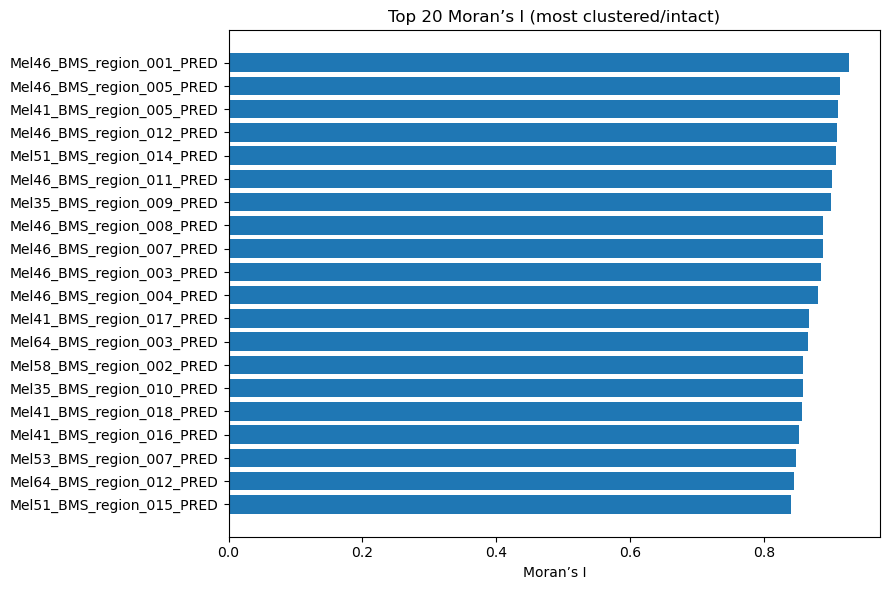

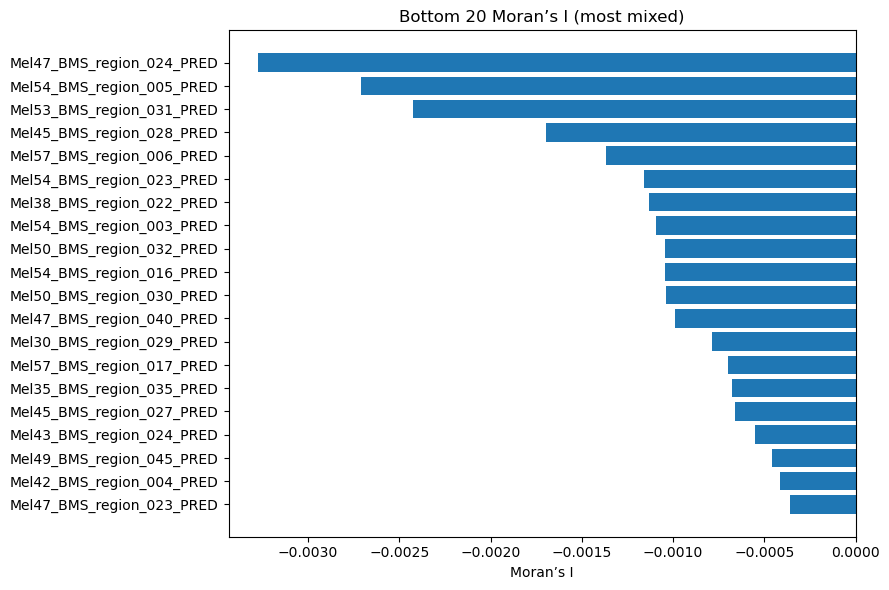

KeyError: 'imageID'

In [ ]:
moran_df = pd.read_csv('/projects/wangc/m344313/OVTMA_project/data/XGBoostPred/BMS_T1_moran_df.csv')

top20 = moran_df.nlargest(20, "moran_I")
bot20 = moran_df.nsmallest(20, "moran_I")

plt.figure(figsize=(9,6))
plt.barh(top20["imageID"].astype(str), top20["moran_I"])
plt.gca().invert_yaxis()
plt.title("Top 20 Moran’s I (most clustered/intact)")
plt.xlabel("Moran’s I"); plt.tight_layout(); plt.show()

plt.figure(figsize=(9,6))
plt.barh(bot20["imageID"].astype(str), bot20["moran_I"])
plt.gca().invert_yaxis()
plt.title("Bottom 20 Moran’s I (most mixed)")
plt.xlabel("Moran’s I"); plt.tight_layout(); plt.show()

for img in top20["imageID"]:
    g = df[df["imageID"] == img]
    plt.figure(figsize=(10,10))
    plt.scatter(g["x"], g["y"], c=g["tumor_bin"], cmap="RdYlBu")
    plt.colorbar(label="Tumor")
    plt.show()

In [ ]:
for img in bot20["imageID"]:
    g = df[df["imageID"] == img]
    plt.figure(figsize=(10,10))
    plt.scatter(g["x"], g["y"], c=g["tumor_bin"], cmap="RdYlBu")
    plt.colorbar(label="Tumor")
    plt.show()

In [7]:
# from the slide margin_labels_umn.pdf
label = {
    'Mel10_Reg001':'Mixed',
    'Mel10_Reg002':'Mixed',
    'Mel10_Reg003':'Unclassified',
    'Mel10_Reg004':'Mixed',
    'Mel10_Reg005':'Intact',
    'Mel10_Reg006':'Mixed',
    'Mel10_Reg007':'Mixed',
    'Mel10_Reg008':'Mixed',
    'Mel10_Reg009':'Mixed',
    'Mel10_Reg010':'Mixed',
    'Mel10_Reg021':'Mixed',
    'Mel10_Reg022':'Mixed',
    'Mel10_Reg023':'Mixed',
    'Mel10_Reg024':'Mixed',
    'Mel10_Reg025':'Mixed',
    'Mel10_Reg026':'Mixed',
    'Mel12_Reg001':'Intact',
    'Mel12_Reg002':'Intact',
    'Mel12_Reg003':'Intact',
    'Mel12_Reg004':'Intact',
    'Mel12_Reg005':'Intact',
    'Mel12_Reg006':'Unclassifed',
    'Mel12_Reg007':'Unclassifed',
    'Mel12_Reg008':'Unclassifed',
    'Mel12_Reg009':'Intact',
    'Mel12_Reg010':'Unclassifed',
    'Mel12_Reg011':'Intact',
    'Mel12_Reg012':'Intact',
    'Mel12_Reg022':'Intact',
    'Mel12_Reg023':'Intact',
    'Mel12_Reg024':'Intact',
    'Mel12_Reg025':'Intact',
    'Mel12_Reg026':'Intact',
    'Mel12_Reg033':'Intact',
    'Mel14_Reg001':'Intact',
    'Mel14_Reg002':'Intact',
    'Mel14_Reg003':'Mixed',
    'Mel14_Reg004':'Mixed',
    'Mel14_Reg005':'Mixed',
    'Mel14_Reg006':'Intact',
    'Mel14_Reg007':'Mixed',
    'Mel14_Reg008':'Mixed',
    'Mel14_Reg009':'Intact',
    'Mel14_Reg010':'Intact',
    'Mel14_Reg011':'Mixed',
    'Mel14_Reg012':'Mixed',
    'Mel14_Reg013':'Intact',
    'Mel14_Reg032':'Intact',
}
df_label = df.copy()
df_label['margin_label'] = df_label['imageID'].map(label)
# remove row if margin_label is NaN
df_label = df_label[df_label['margin_label'].notna()]




In [8]:
df_label

,patientID,imageID,responder,fov,x,y,cell_type,margin_label
